## Load Encoded Captions

In [1]:
import h5py
from os.path import join
import numpy as np
import random
import skimage
import skimage.io
import skimage.transform
import matplotlib.pyplot as plt
%matplotlib inline
import tensorflow as tf

In [2]:
data_dir = 'Data'
h = h5py.File(join(data_dir, 'flower_tv.hdf5'))

In [3]:
flower_captions = {}
for ds in dict(h).items():
    flower_captions[ds[0]] = np.array(ds[1])

In [4]:
# each image has 5 captions each vectorized into 4800 vectors
flower_captions['image_05349.jpg']

array([[  1.12434858e-02,  -1.09033026e-02,  -5.40558062e-03, ...,
          4.71095368e-03,   3.07553913e-03,  -7.88170006e-03],
       [  5.23057580e-03,  -1.70876943e-02,  -5.15448023e-03, ...,
          1.07166674e-02,   1.85983779e-03,  -2.78546521e-03],
       [  2.36820132e-02,  -7.51516828e-03,  -5.73695637e-03, ...,
          6.86524883e-02,   1.42409978e-03,  -1.04672341e-02],
       [  3.76328523e-03,   2.30614142e-03,  -4.49462328e-03, ...,
         -1.71718730e-05,   2.64344364e-03,  -8.79086379e-04],
       [  1.11399777e-02,  -4.91742557e-03,  -8.57677124e-03, ...,
          6.91645890e-02,   1.77751575e-03,  -6.18656259e-03]], dtype=float32)

## How to create embedding with a new sentence

In [5]:
import imp
imp.load_source("skipthoughts", "./skip-thoughts/skipthoughts.py") 
import skipthoughts

model = skipthoughts.load_model()
#skipthoughts.load_tables()
encoder = skipthoughts.Encoder(model)


Loading model parameters...
Compiling encoders...
Loading tables...
Packing up...


In [6]:
imp.load_source("skipthoughts", "./skip-thoughts/skipthoughts.py") 
import skipthoughts
vectors = encoder.encode(["Hello World!", "how are you"],verbose=True)

3


In [7]:
vectors

array([[ 0.00289424, -0.01340304, -0.0031364 , ..., -0.00020494,
         0.00080485, -0.00859977],
       [ 0.00222143, -0.01256226, -0.01843037, ..., -0.00421009,
         0.01834102, -0.01412066]], dtype=float32)

## Prep Inputs For GAN

In [8]:
def load_training_data(data_dir, data_set='flowers'):
	if data_set == 'flowers':
		h = h5py.File(join(data_dir, 'flower_tv.hdf5'))
		flower_captions = {}
		for ds in h.items():
			flower_captions[ds[0]] = np.array(ds[1])
		image_list = [key for key in flower_captions]
		image_list.sort()

		img_75 = int(len(image_list)*1) # can be changed if don't need all pic
		training_image_list = image_list[0:img_75]
		#random.shuffle(training_image_list)
		
		return {
			'image_list' : training_image_list,
			'captions' : flower_captions,
			'data_length' : len(training_image_list)
		}

flower_cap = load_training_data(data_dir)

In [9]:
print (flower_cap['image_list'][0])
print (flower_cap['captions'][flower_cap['image_list'][0]])
print (flower_cap['data_length'])

image_00001.jpg
[[ 0.00247043 -0.00978464 -0.01372992 ..., -0.02817912  0.03375437
  -0.00589225]
 [ 0.01244221 -0.01928648 -0.00613386 ..., -0.0065219   0.00466952
  -0.01222099]
 [ 0.01298153 -0.00059234 -0.00383552 ...,  0.02389688  0.00137579
  -0.01621519]
 [ 0.00446556 -0.0084612  -0.00732049 ...,  0.00601037  0.00218833
   0.00555609]
 [ 0.01124559 -0.0070828  -0.0034986  ..., -0.02691613  0.0067353
  -0.00037385]]
8189


In [10]:
def load_image_array(image_file, image_size):
    img = skimage.io.imread(image_file)
    # GRAYSCALE
    if len(img.shape) == 2:
        img_new = np.ndarray( (img.shape[0], img.shape[1], 3), dtype = 'uint8')
        img_new[:,:,0] = img
        mg_new[:,:,1] = img
        img_new[:,:,2] = img
        img = img_new

    img_resized = skimage.transform.resize(img, (image_size, image_size))
    
    return img_resized.astype('float32')
    

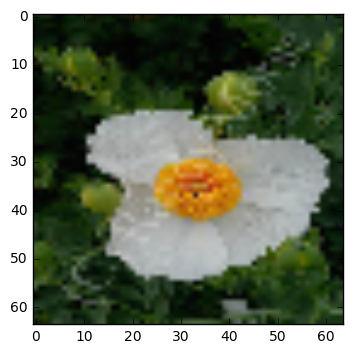

In [11]:

dir_img = join('Data/flowers/jpg', 'image_05306.jpg')
im = load_image_array(dir_img, 64)
plt.imshow(im)


In [20]:
#Compile training dataset: ID, Image (X), Embedding (Y)
img_id = flower_cap['image_list']
Y = np.zeros((flower_cap['data_length']*5,2400))
X= np.zeros((flower_cap['data_length'],64,64,3))
n=0

for i in img_id:
    for c in range(0,5):
        Y[(n*5+c),:] = flower_cap['captions'][i][c][0:2400]
    X[n,:,:,:] = load_image_array(join('Data/flowers/jpg', i), 64)
    n += 1

In [21]:
print (X.shape)
print (Y.shape)

(8189, 64, 64, 3)
(40945, 2400)


## Conditional GAN

In [31]:

# Hyperparameters
mb_size = 128
num_epochs = 3000
Z_dim = 100
image_size = 64
label_size = Y.shape[1]  #2400 for skip-thought
D_learning_rate = 0.0002
G_learning_rate = 0.0002


def generate_a_graph(i,label_test): # generate image by label
    label_y = label_test[i][0:label_size].reshape(1, label_size)
    z = np.random.uniform(-1., 1., size=[1, Z_dim])
    g = sess.run(G_sample, feed_dict={Z_ph: z, Y_real:label_y})
    return (g.reshape(image_size, image_size,3))

In [32]:
def sample_Z(m, n):
    '''Uniform prior for G(Z)'''
    return np.random.uniform(-1., 1., size=[m, n])

def batch_iter(data, label, batch_size, num_epochs, shuffle=True):
    """
    Generates a batch iterator for a dataset.
    """
    data = np.array(data)
    data_size = len(data)
    num_batches_per_epoch = int((len(data)-1)/batch_size) + 1
    for epoch in range(num_epochs):
        # Shuffle the data at each epoch
        if shuffle:
            shuffle_true_indices = np.random.permutation(np.arange(data_size))
            shuffle_false_indices = np.random.permutation(np.arange(data_size)) # need to check this
        for batch_num in range(num_batches_per_epoch):
            random_caption_index = random.randint(0,4) # random selection of one of the 5 caption each batch
            shuffle_true_label_index = [(x*5+random_caption_index) for x in shuffle_true_indices]
            shuffle_false_label_index = [(x*5+random_caption_index) for x in shuffle_false_indices]
            start_index = batch_num * batch_size
            end_index = min((batch_num + 1) * batch_size, data_size)
            image_true =  data[shuffle_true_indices[start_index:end_index]]
            #image_false = data[shuffle_false_indices[start_index:end_index]]
            label_true = label[shuffle_true_label_index[start_index:end_index]]
            label_false = label[shuffle_false_label_index[start_index:end_index]]
            yield (image_true, label_true, label_false)

In [33]:
# Construct the conditional GAN

tf.reset_default_graph()

def xavier_init(size):
    return tf.random_normal(shape=size, stddev=(1. / tf.sqrt(size[0] / 2.)))

def generator(z, y):
    z_y = tf.concat([z, y], 1)
    G_h1 = tf.nn.relu(tf.matmul(z_y, G_W1) + G_b1)
    G_h2 = tf.nn.relu(tf.matmul(G_h1, G_W2) + G_b2)
    G_log_prob = tf.matmul(G_h2, G_W3) + G_b3
    G_prob = tf.nn.sigmoid(G_log_prob)
    return G_prob

def discriminator(x, y):
    x_y = tf.concat([x, y], 1)
    D_h1 = tf.nn.relu(tf.matmul(tf.contrib.layers.flatten(x_y), D_W1) + D_b1)
    D_h2 = tf.nn.relu(tf.matmul(D_h1, D_W2) + D_b2)
    D_logit = tf.matmul(D_h2, D_W3) + D_b3
    D_prob = tf.nn.sigmoid(D_logit)
    return D_prob, D_logit


# Discriminator Net
X_ph = tf.placeholder(tf.float32, shape=[None, (image_size*image_size*3)], name='X')
Y_real = tf.placeholder(tf.float32, shape=[None, label_size], name='Y_real')
Y_fake = tf.placeholder(tf.float32, shape=[None, label_size], name='Y_fake')

D_W1 = tf.Variable(xavier_init([(image_size*image_size*3+label_size), 1000]), name='D_W1')
D_b1 = tf.Variable(tf.zeros(shape=[1000]), name='D_b1')

D_W2 = tf.Variable(xavier_init([1000, 256]), name='D_W2') #
D_b2 = tf.Variable(tf.zeros(shape=[256]), name='D_b2') #

D_W3 = tf.Variable(xavier_init([256, 1]), name='D_W3') #
D_b3 = tf.Variable(tf.zeros(shape=[1]), name='D_b3') #

theta_D = [D_W1, D_W2, D_b1, D_b2, D_W3, D_b3]


# Generator Net
Z_ph = tf.placeholder(tf.float32, shape=[None, Z_dim], name='Z')

G_W1 = tf.Variable(xavier_init([Z_dim+label_size, 256]), name='G_W1')
G_b1 = tf.Variable(tf.zeros(shape=[256]), name='G_b1')

G_W2 = tf.Variable(xavier_init([256, 1000]), name='G_W2') #
G_b2 = tf.Variable(tf.zeros(shape=[1000]), name='G_b2') #

G_W3 = tf.Variable(xavier_init([1000, (image_size*image_size*3) ]), name='G_W3') #
G_b3 = tf.Variable(tf.zeros(shape=[(image_size*image_size*3)]), name='G_b3') #

theta_G = [G_W1, G_W2, G_b1, G_b2, G_W3, G_b3]


# losses and MaxMin
G_sample = generator(Z_ph, Y_real)

D_real, D_logit_real = discriminator(X_ph, Y_real)
D_fake, D_logit_fake = discriminator(G_sample,Y_real)
D_real_fake, D_logit_real_fake = discriminator(X_ph, Y_fake)

D_loss = -tf.reduce_mean(tf.log(D_real) + (tf.log(1. - D_fake) + tf.log(1. - D_real_fake))/2)
G_loss = -tf.reduce_mean(tf.log(D_fake))

# Only update D(X)'s parameters, so var_list = theta_D
D_solver = tf.train.AdamOptimizer(D_learning_rate,beta1=0.5).minimize(D_loss, var_list=theta_D)
# Only update G(X)'s parameters, so var_list = theta_G
G_solver = tf.train.AdamOptimizer(G_learning_rate,beta1=0.5).minimize(G_loss, var_list=theta_G)


Iter: 1
D loss: 1.4
G_loss: 0.697



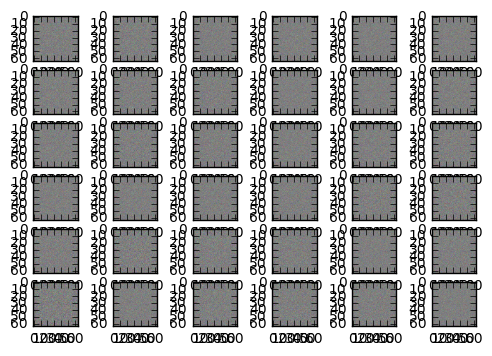

Iter: 2000
D loss: 1.296
G_loss: 0.8397



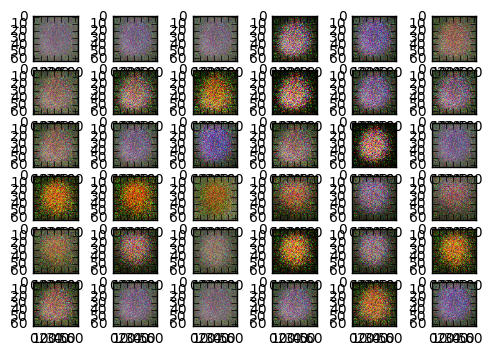

Iter: 4000
D loss: 1.594
G_loss: 0.3891



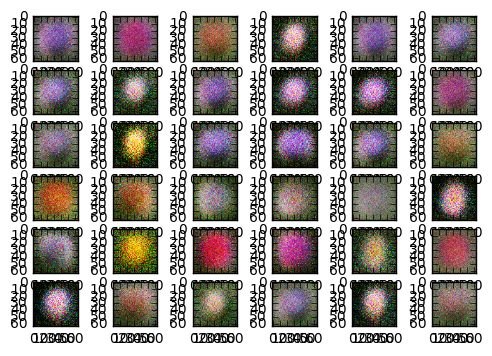

Iter: 6000
D loss: 1.298
G_loss: 0.8663



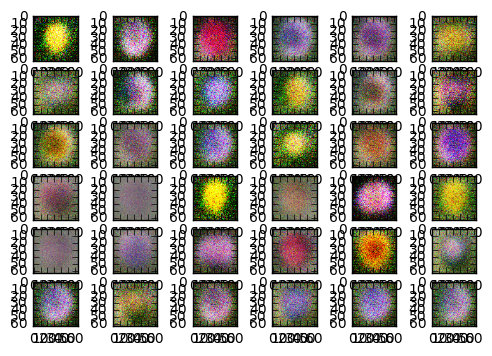

Iter: 8000
D loss: 1.37
G_loss: 0.6982



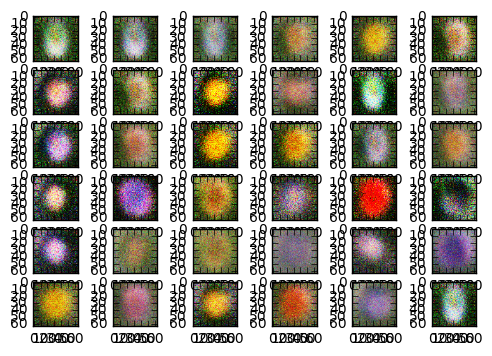

Iter: 10000
D loss: 1.391
G_loss: 0.6511



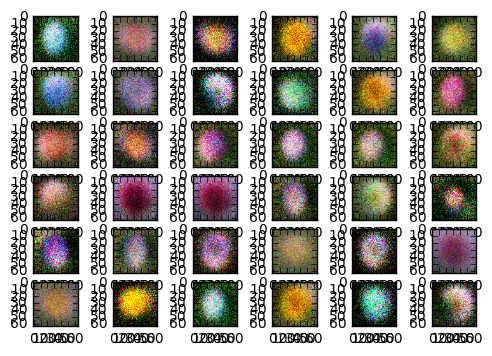

Iter: 12000
D loss: 1.342
G_loss: 0.8143



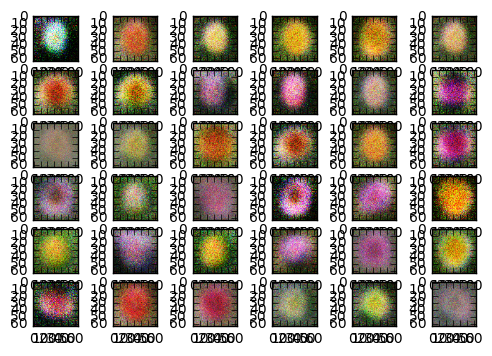

Iter: 14000
D loss: 1.321
G_loss: 0.8381



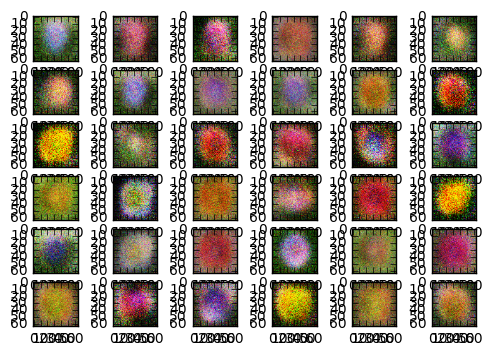

Iter: 16000
D loss: 1.35
G_loss: 0.7509



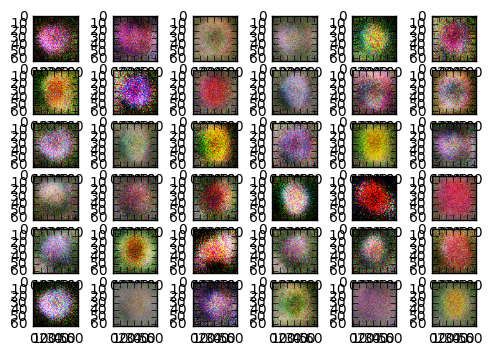

Iter: 18000
D loss: 1.349
G_loss: 0.7598



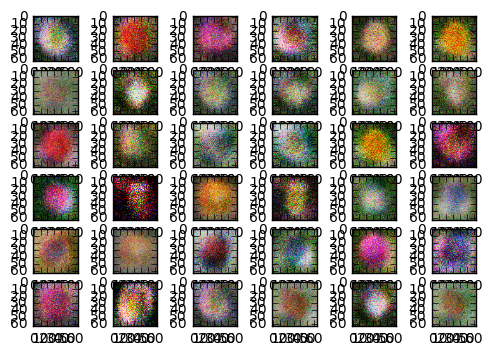

Iter: 20000
D loss: 1.305
G_loss: 0.8668



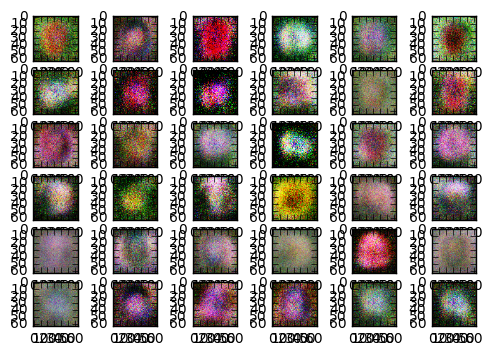

Iter: 22000
D loss: 1.277
G_loss: 0.9149



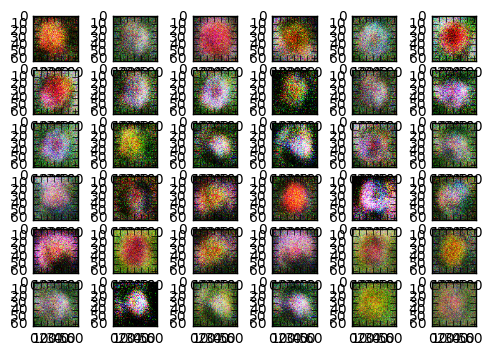

Iter: 24000
D loss: 1.262
G_loss: 1.017



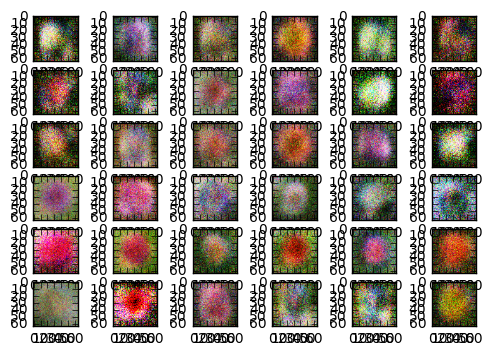

Iter: 26000
D loss: 1.235
G_loss: 0.9192



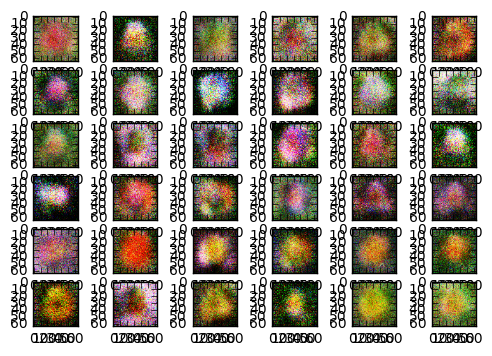

Iter: 28000
D loss: 1.296
G_loss: 1.073



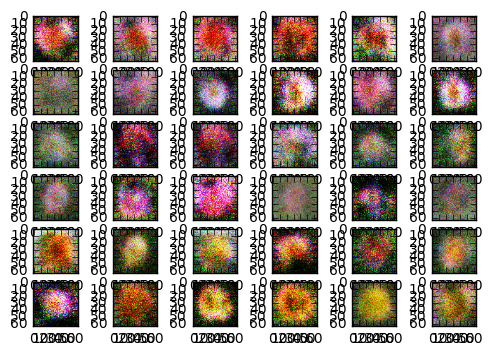

Iter: 30000
D loss: 1.27
G_loss: 0.7445



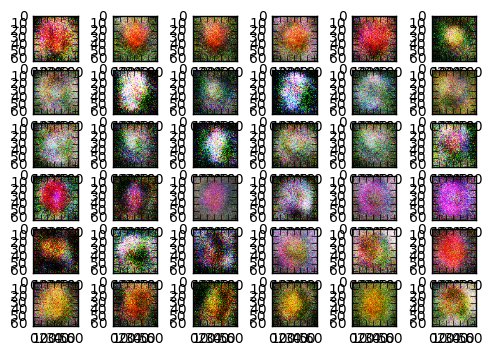

Iter: 32000
D loss: 1.305
G_loss: 0.8176



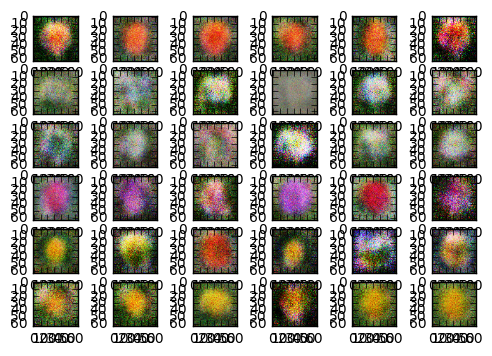

Iter: 34000
D loss: 1.221
G_loss: 0.9484



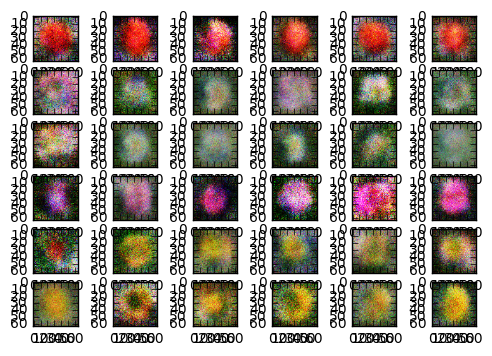

Iter: 36000
D loss: 1.237
G_loss: 0.8449



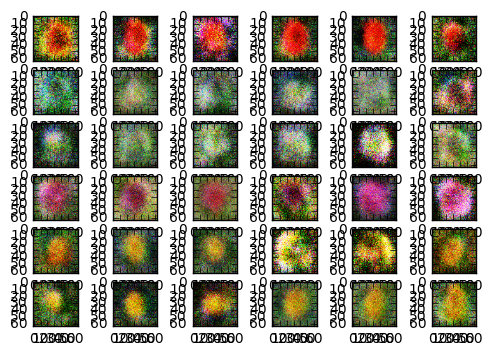

Iter: 38000
D loss: 1.173
G_loss: 0.9221



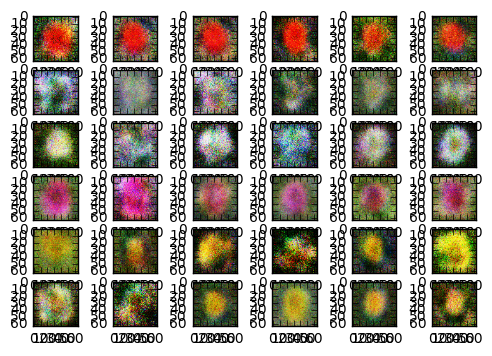

Iter: 40000
D loss: 1.154
G_loss: 1.255



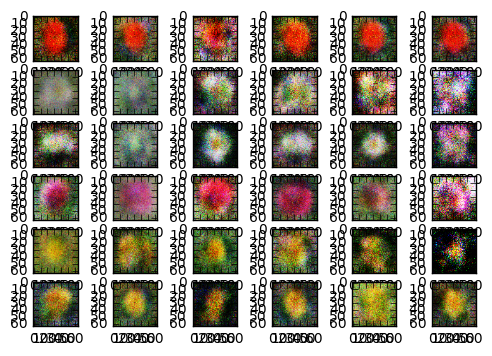

Iter: 42000
D loss: 1.098
G_loss: 1.025



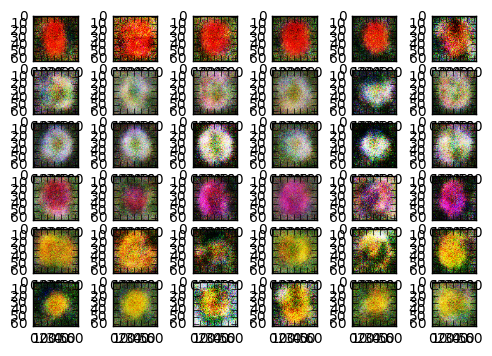

Iter: 44000
D loss: 1.167
G_loss: 1.643



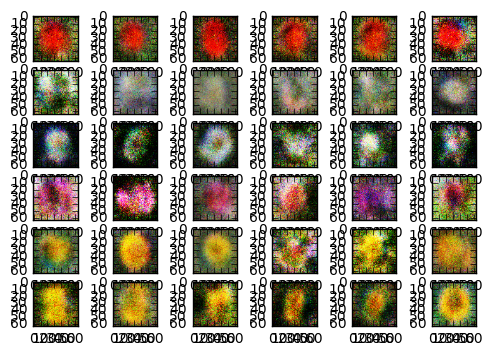

Iter: 46000
D loss: 1.127
G_loss: 0.9005



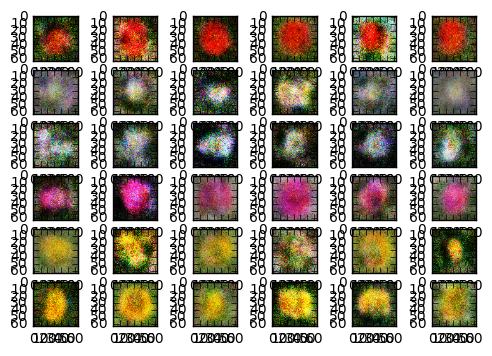

Iter: 48000
D loss: 1.13
G_loss: 1.643



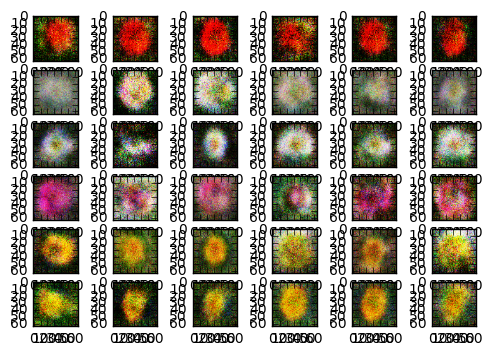

Iter: 50000
D loss: 1.07
G_loss: 1.893



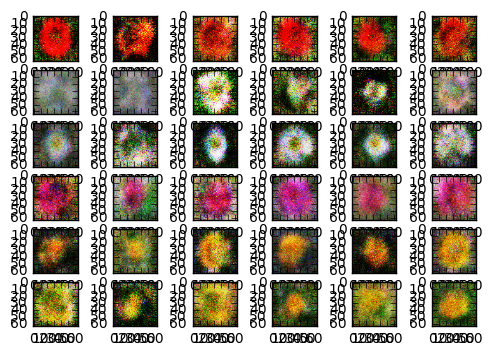

Iter: 52000
D loss: 0.9207
G_loss: 1.938



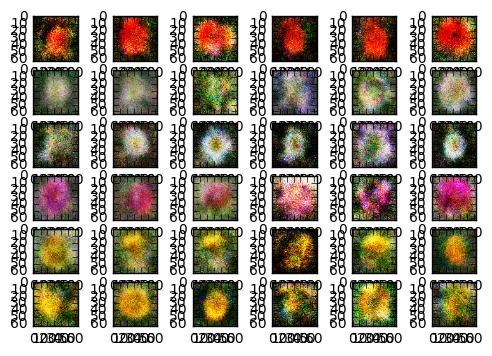

Iter: 54000
D loss: 1.195
G_loss: 2.459



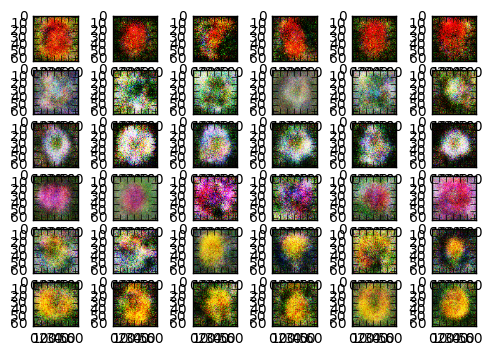

Iter: 56000
D loss: 1.028
G_loss: 1.785



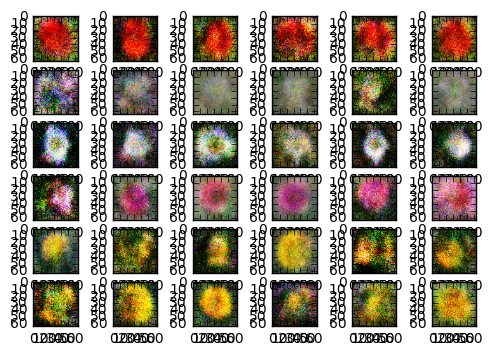

Iter: 58000
D loss: 1.215
G_loss: 0.9138



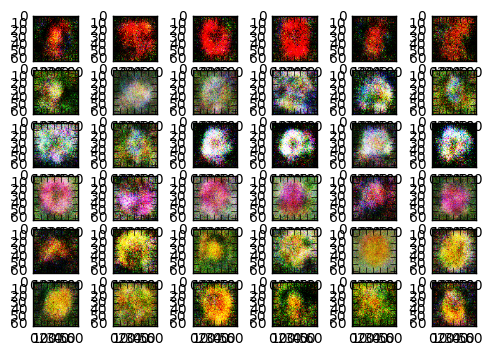

Iter: 60000
D loss: 0.9597
G_loss: 1.671



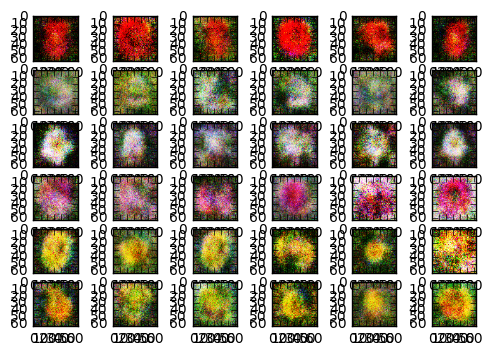

Iter: 62000
D loss: 1.035
G_loss: 1.56



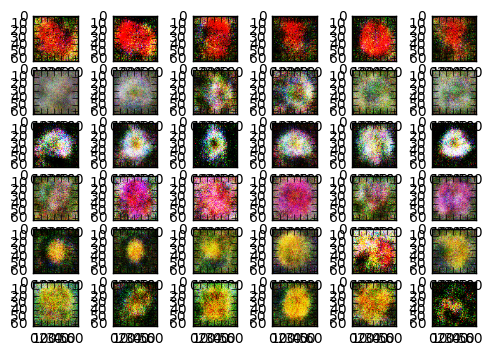

Iter: 64000
D loss: 1.091
G_loss: 1.371



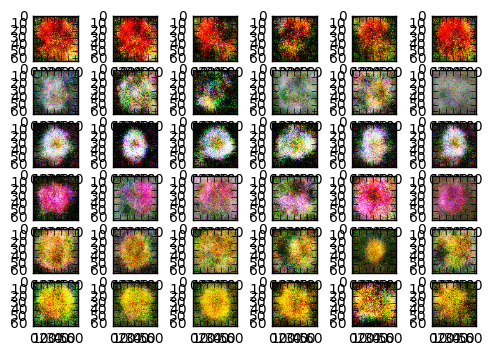

Iter: 66000
D loss: 1.175
G_loss: 1.158



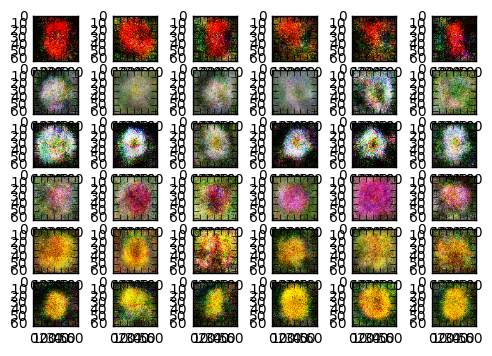

Iter: 68000
D loss: 1.384
G_loss: 0.9293



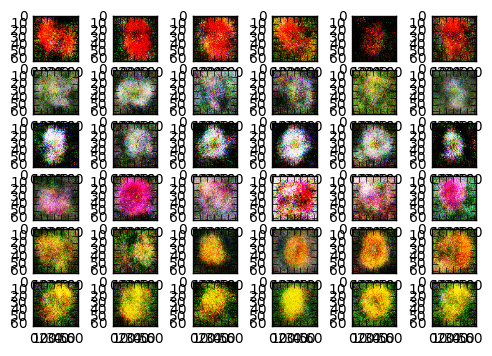

Iter: 70000
D loss: 0.9153
G_loss: 1.568



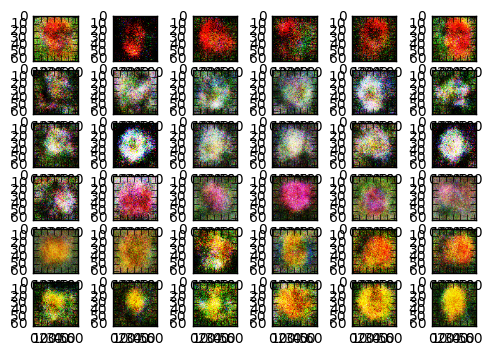

Iter: 72000
D loss: 1.045
G_loss: 1.252



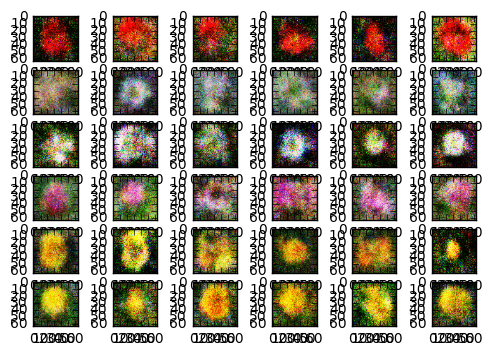

Iter: 74000
D loss: 0.9201
G_loss: 1.465



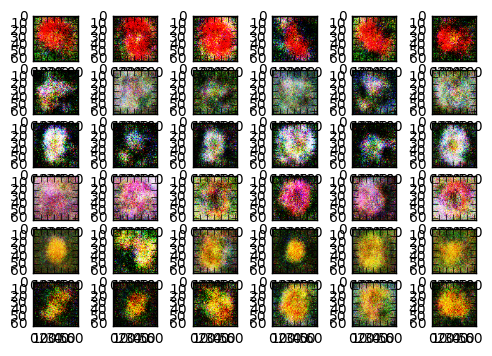

Iter: 76000
D loss: 0.9812
G_loss: 1.527



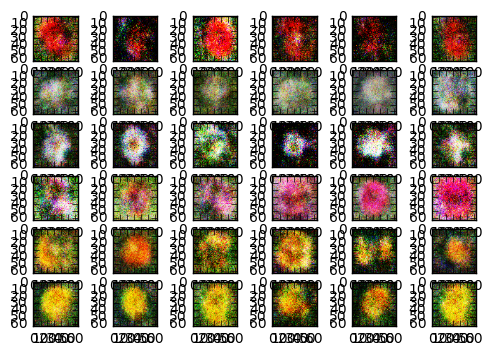

Iter: 78000
D loss: 0.8725
G_loss: 1.965



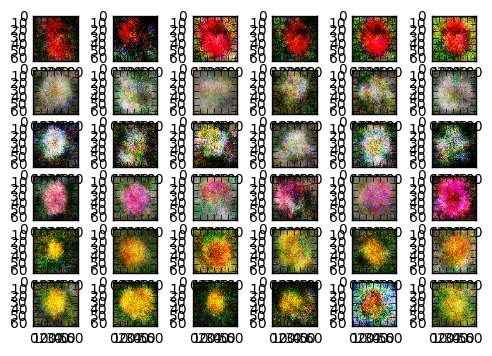

Iter: 80000
D loss: 0.9864
G_loss: 1.701



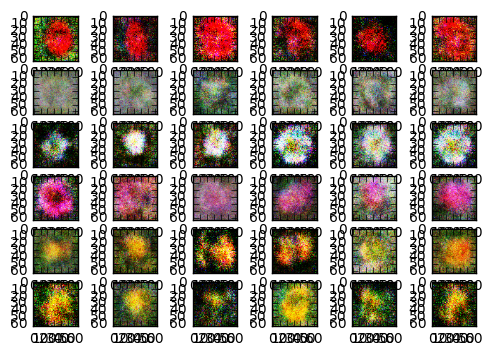

Iter: 82000
D loss: 0.9854
G_loss: 1.251



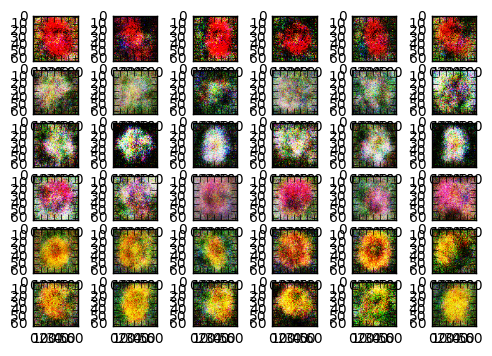

Iter: 84000
D loss: 1.001
G_loss: 1.557



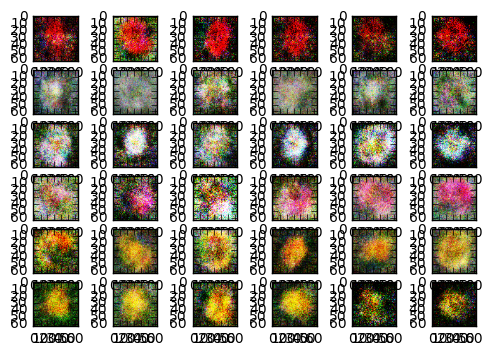

Iter: 86000
D loss: 0.9902
G_loss: 2.094



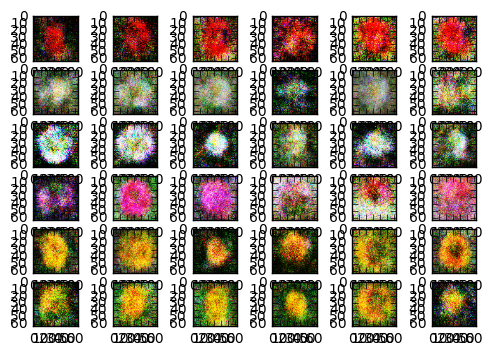

Iter: 88000
D loss: 1.368
G_loss: 1.103



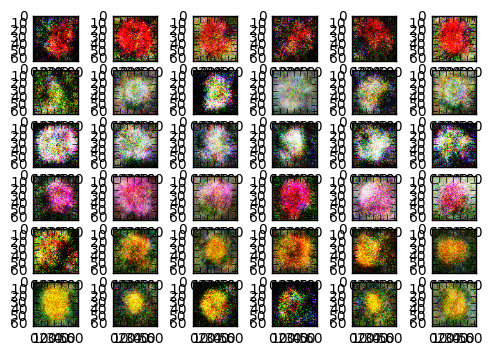

Iter: 90000
D loss: 0.9226
G_loss: 1.268



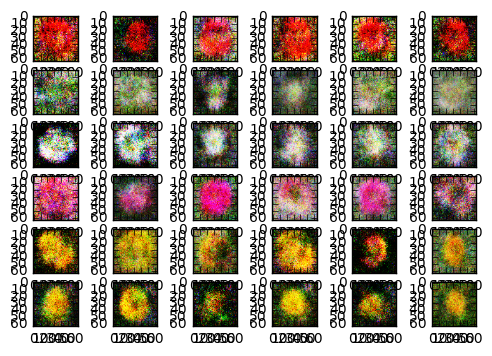

Iter: 92000
D loss: 0.9284
G_loss: 2.043



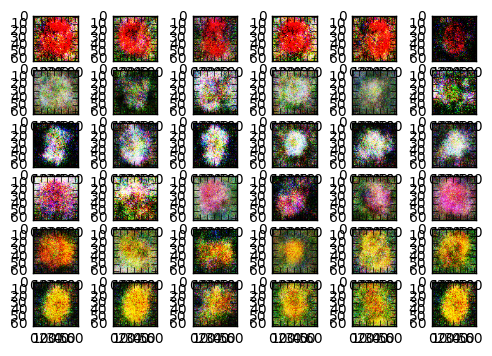

Iter: 94000
D loss: 0.9249
G_loss: 1.458



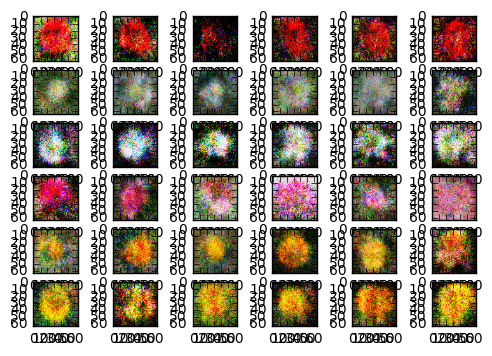

Iter: 96000
D loss: 0.9259
G_loss: 1.574



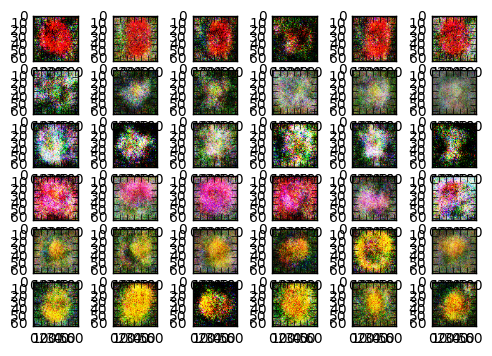

Iter: 98000
D loss: 1.017
G_loss: 1.539



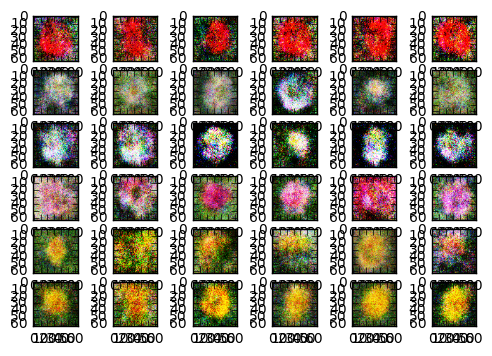

Iter: 100000
D loss: 0.8187
G_loss: 2.237



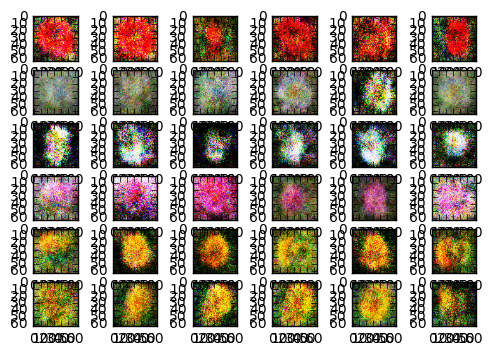

Iter: 102000
D loss: 0.86
G_loss: 1.627



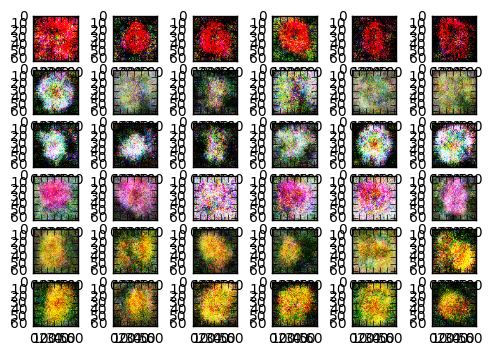

Iter: 104000
D loss: 0.9308
G_loss: 1.77



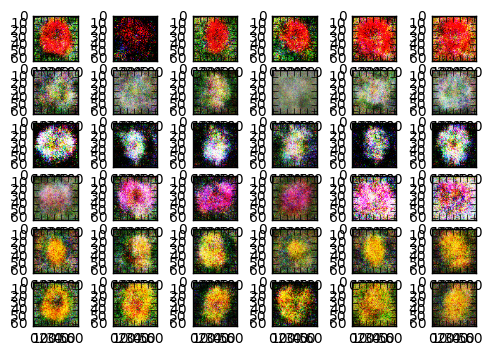

Iter: 106000
D loss: 0.8555
G_loss: 1.715



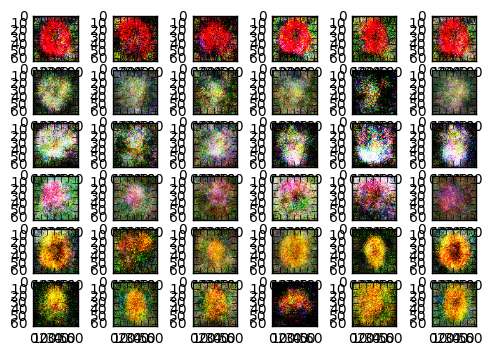

Iter: 108000
D loss: 0.8674
G_loss: 1.792



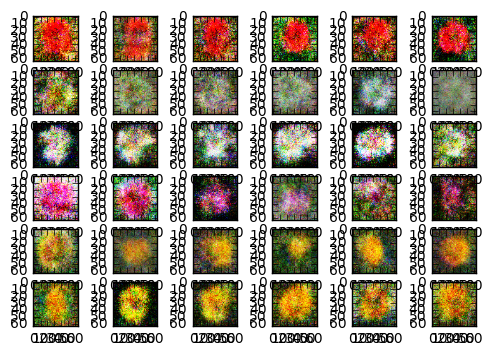

Iter: 110000
D loss: 0.9368
G_loss: 1.815



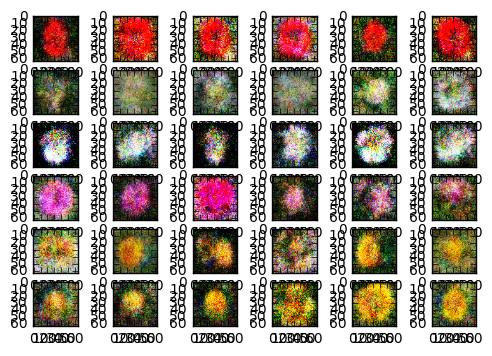

Iter: 112000
D loss: 0.8302
G_loss: 1.738



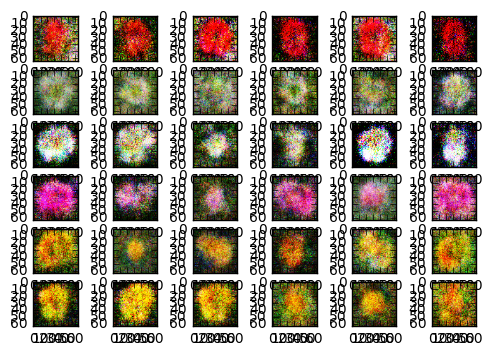

Iter: 114000
D loss: 0.8451
G_loss: 2.229



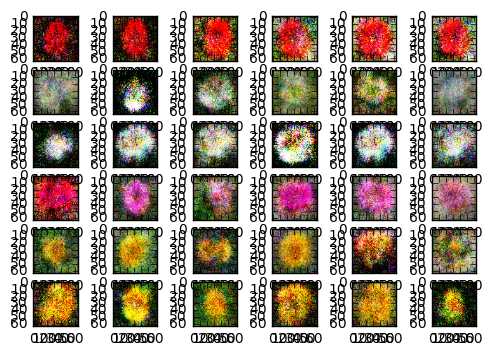

Iter: 116000
D loss: 0.9031
G_loss: 1.776



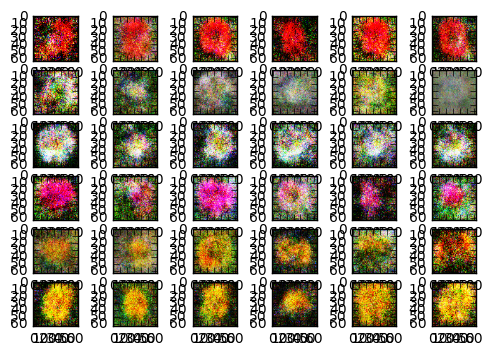

Iter: 118000
D loss: 1.388
G_loss: 0.8407



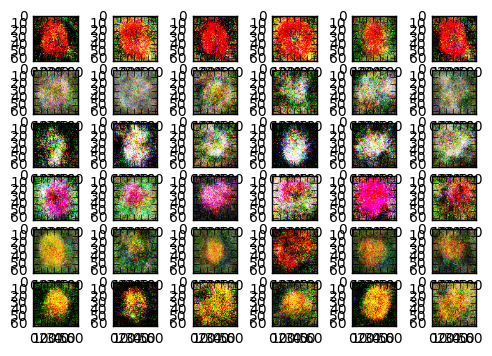

Iter: 120000
D loss: 0.9427
G_loss: 2.273



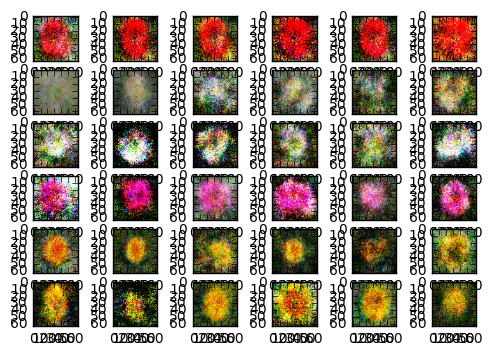

Iter: 122000
D loss: 0.7774
G_loss: 2.06



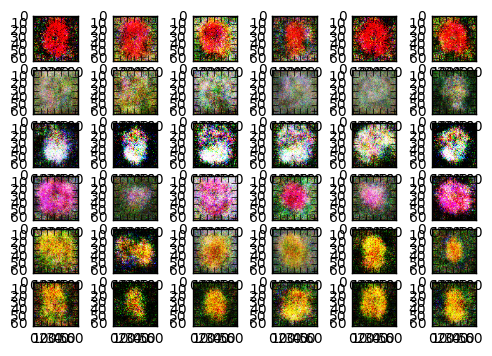

Iter: 124000
D loss: 0.8271
G_loss: 1.764



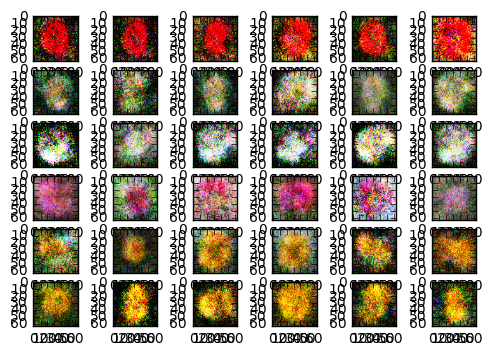

Iter: 126000
D loss: 1.059
G_loss: 1.439



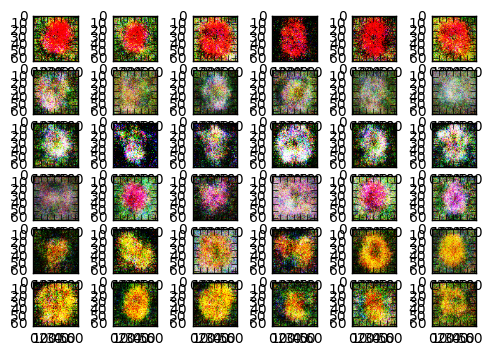

Iter: 128000
D loss: 0.9255
G_loss: 2.684



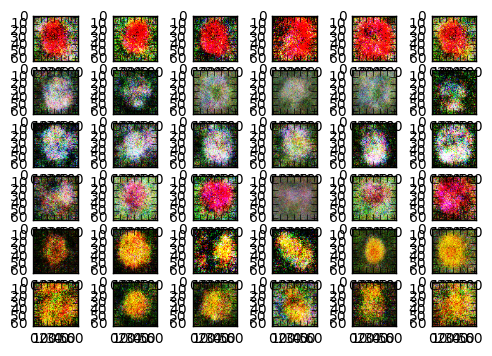

Iter: 130000
D loss: 0.8925
G_loss: 2.548



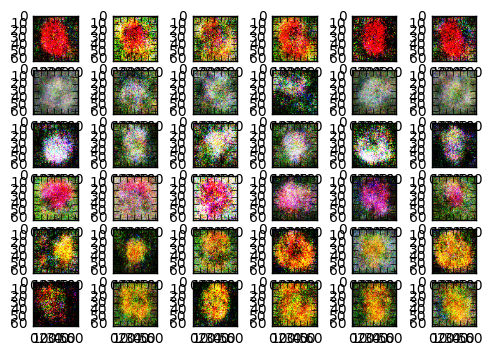

Iter: 132000
D loss: 0.7453
G_loss: 2.476



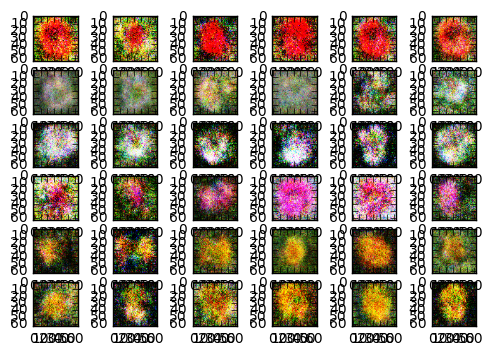

Iter: 134000
D loss: 0.8267
G_loss: 1.605



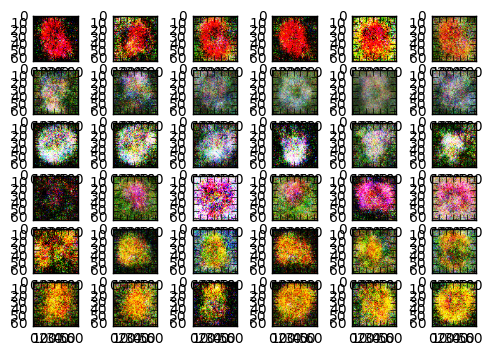

Iter: 136000
D loss: 0.7775
G_loss: 1.976



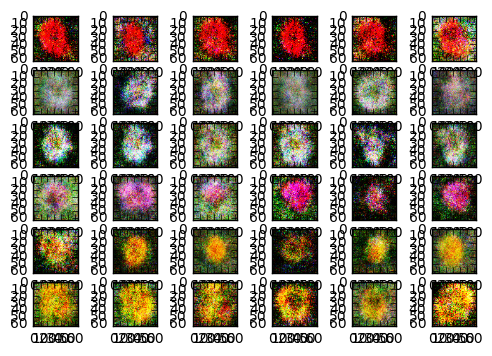

Iter: 138000
D loss: 0.7992
G_loss: 2.277



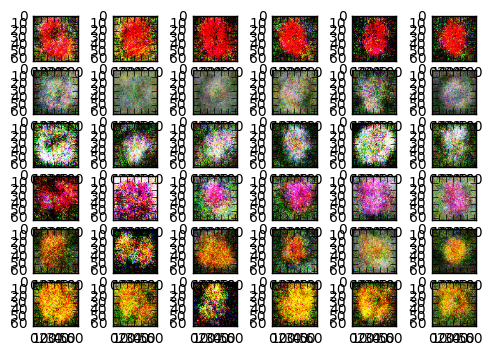

Iter: 140000
D loss: 0.7049
G_loss: 2.012



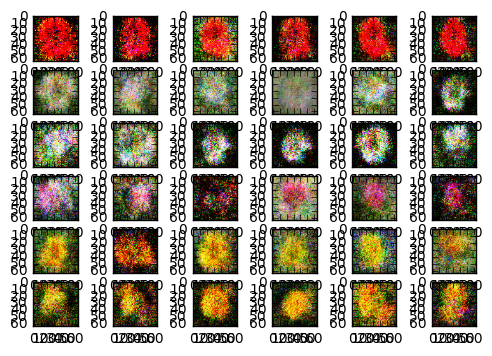

Iter: 142000
D loss: 0.7712
G_loss: 2.362



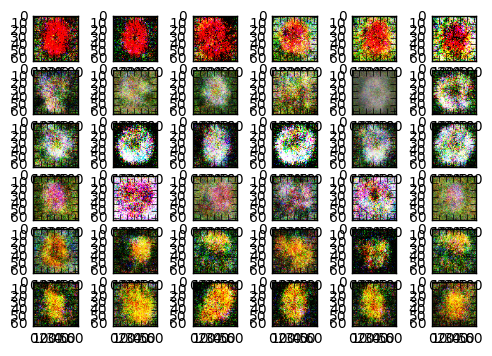

Iter: 144000
D loss: 0.8286
G_loss: 1.998



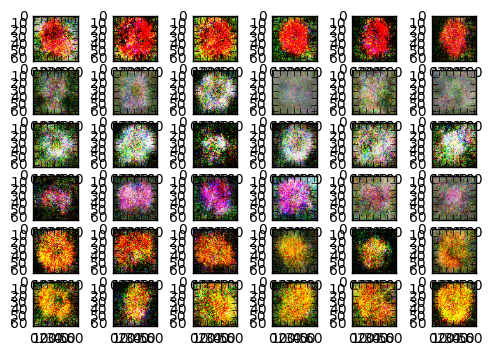

Iter: 146000
D loss: 0.7952
G_loss: 2.06



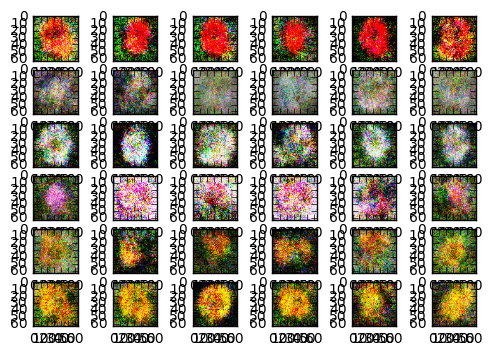

Iter: 148000
D loss: 0.7775
G_loss: 1.664



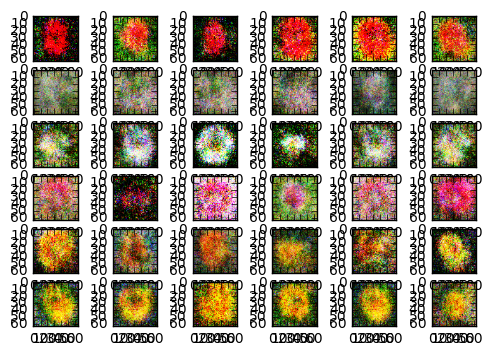

Iter: 150000
D loss: 0.7836
G_loss: 2.094



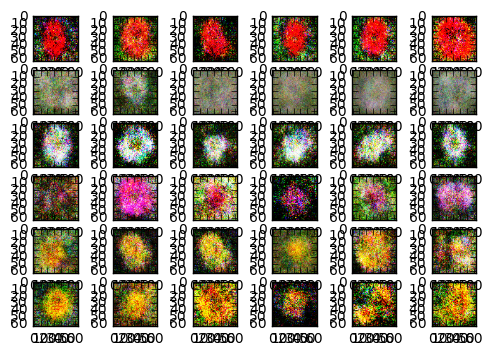

Iter: 152000
D loss: 1.073
G_loss: 3.971



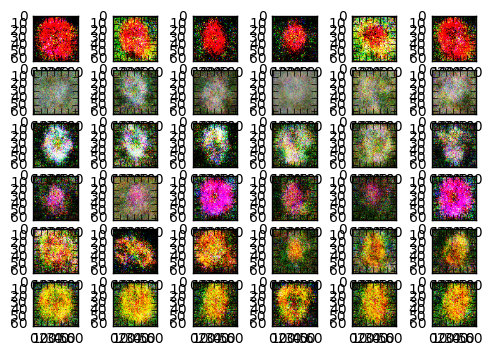

Iter: 154000
D loss: 0.746
G_loss: 1.867



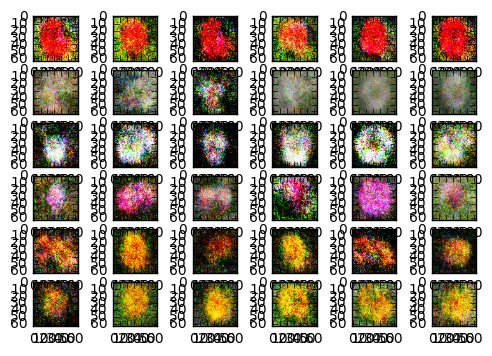

Iter: 156000
D loss: 0.971
G_loss: 1.78



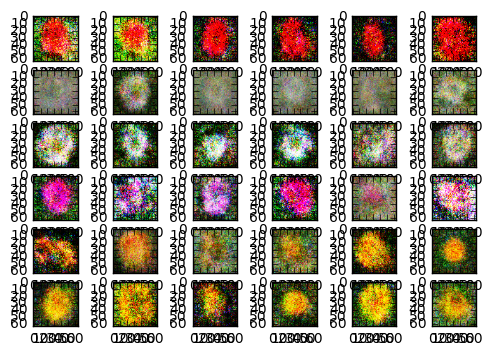

Iter: 158000
D loss: 0.7829
G_loss: 2.084



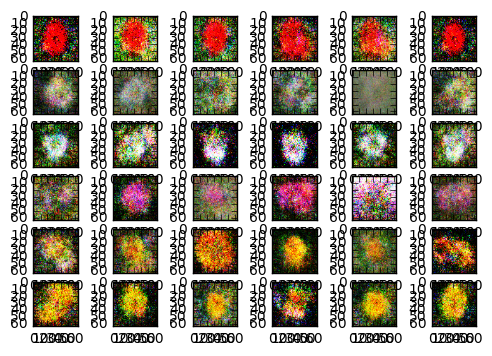

Iter: 160000
D loss: 0.7432
G_loss: 1.757



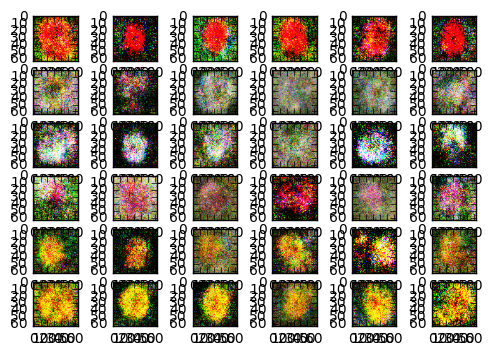

Iter: 162000
D loss: 0.8481
G_loss: 1.983



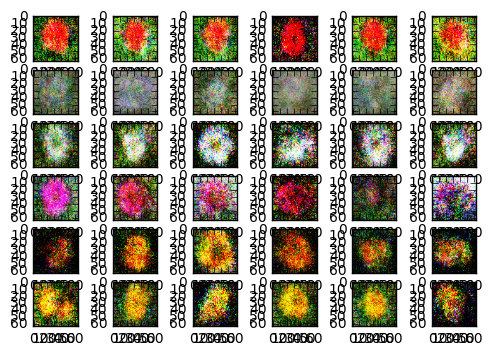

Iter: 164000
D loss: 0.7662
G_loss: 2.64



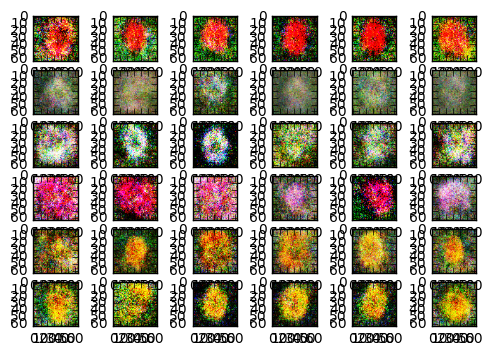

Iter: 166000
D loss: 0.8092
G_loss: 1.809



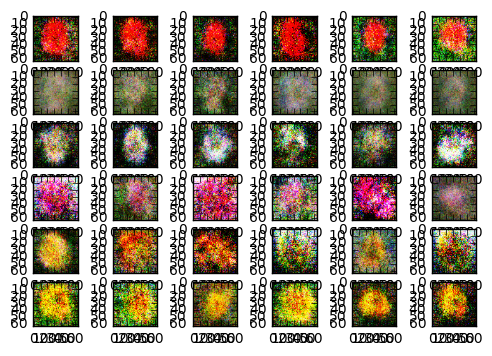

Iter: 168000
D loss: 0.8033
G_loss: 2.038



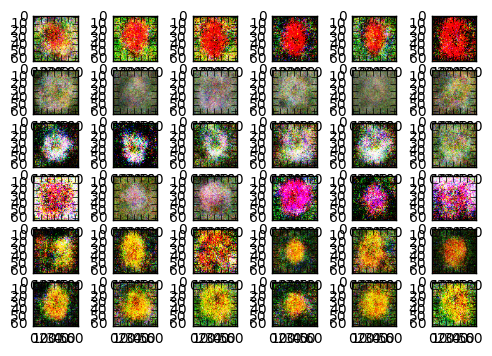

Iter: 170000
D loss: 0.7542
G_loss: 1.924



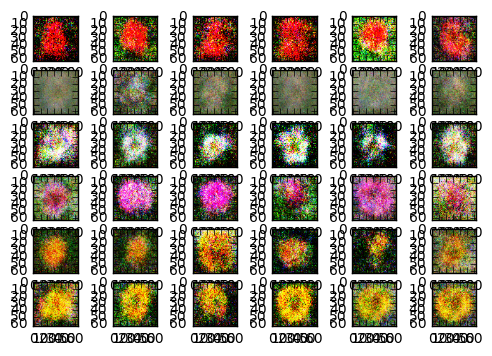

Iter: 172000
D loss: 0.8345
G_loss: 2.092



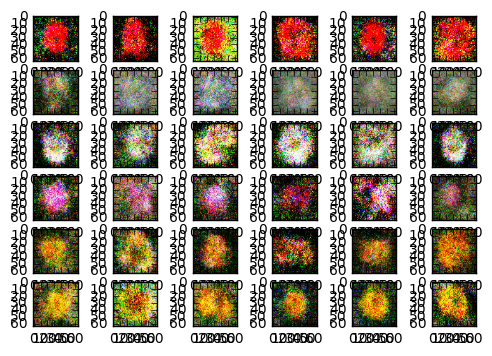

Iter: 174000
D loss: 0.7558
G_loss: 2.067



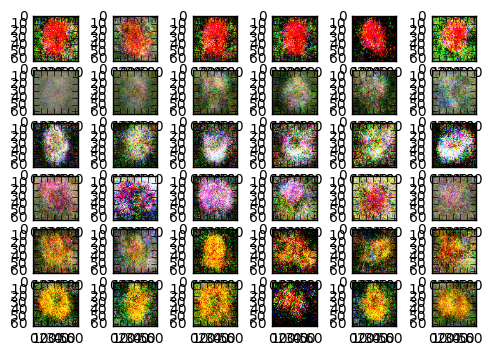

Iter: 176000
D loss: 0.7437
G_loss: 1.923



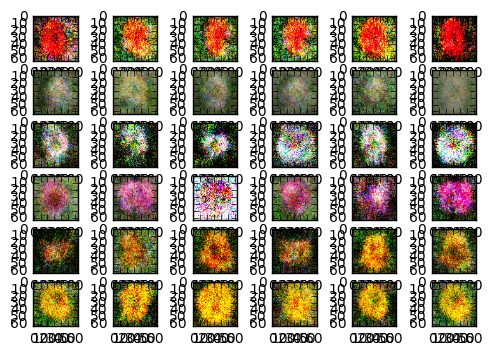

Iter: 178000
D loss: nan
G_loss: nan



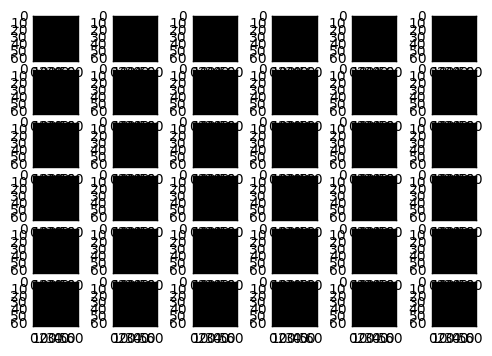

KeyboardInterrupt: 

In [34]:
## Run the conditional GAN model

# define global steps 
global_step = tf.Variable(0, name="global_step", trainable=False)
incr_global_step_op = tf.assign(global_step, global_step+1)

# define test label 
caption = [
    'the flower shown has yellow anther red pistil and bright red petals',
    'this flower has petals that are yellow, white and purple and has dark lines',
    'the petals on this flower are white with a yellow center',
    'this flower has a lot of small round pink petals.',
    'this flower is orange in color, and has petals that are ruffled and rounded.',
    'the flower has yellow petals and the center of it is brown']
label_test = encoder.encode(caption,verbose=False)

# start tf session
sess = tf.Session(config=tf.ConfigProto(log_device_placement=True))
sess.run(tf.global_variables_initializer())

# initialize loss
D_loss_c = []
G_loss_c = []

# Run in mini batch
batches = batch_iter(X, Y, mb_size, num_epochs)

for image_true, label_true, label_false in batches:
    
    _, D_loss_curr, _, G_loss_curr, i = sess.run([D_solver, D_loss, G_solver, G_loss, incr_global_step_op]
                                                 ,feed_dict={X_ph: image_true.reshape([-1,(image_size*image_size*3)])
                                                             , Y_real: label_true
                                                             , Y_fake: label_false
                                                             , Z_ph:sample_Z(image_true.shape[0], Z_dim)
                                                             })
    # print some loss during the training
    if i % 2000 == 0 or i==1:
        print('Iter: {}'.format(i))
        print('D loss: {:.4}'. format(D_loss_curr))
        print('G_loss: {:.4}'.format(G_loss_curr))
        print()
        D_loss_c.append(D_loss_curr)
        G_loss_c.append(G_loss_curr)
        
        # generate plot with set label during the training    
        f, axarr = plt.subplots(6,6)
        for n in range(6):
            for m in range(6):
                im = generate_a_graph(n,label_test)
                axarr[n,m].imshow(im)
        plt.show()

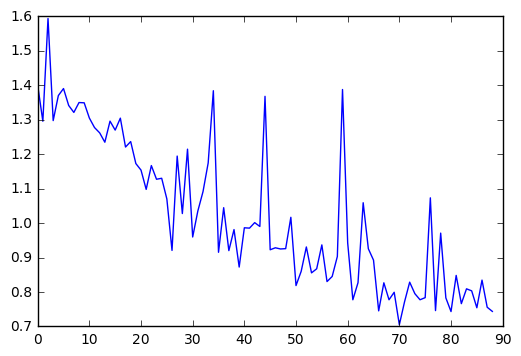

In [35]:
plt.plot(D_loss_c)
plt.show()

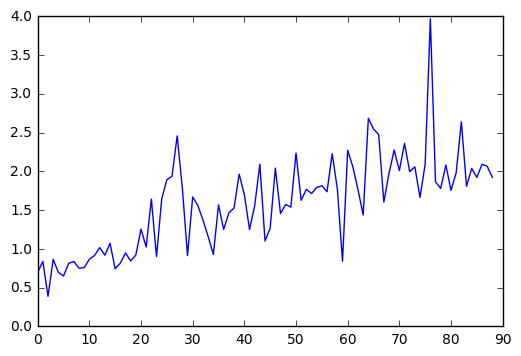

In [36]:
plt.plot(G_loss_c)
plt.show()

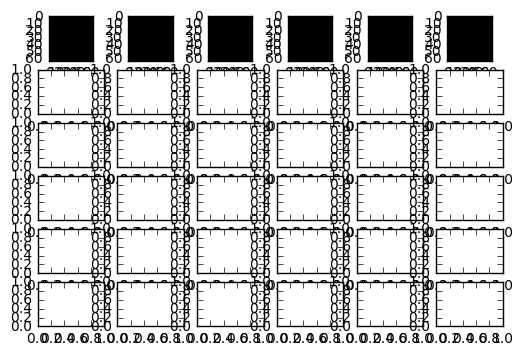

In [38]:

f, axarr = plt.subplots(6,6)
for n in range(6):
    for m in range(6):
         im = generate_a_graph(n,label_test)
         axarr[n,m].imshow(im)
    plt.show()